In [1]:
import seaborn as sns
import pandas as pd
import numpy as np
import plotly.express as px
import matplotlib.pyplot as plt

from src.features import load_trips, remove_outliers

sns.set_theme()

# Load data

In [2]:
# %time tmp = load_trips(['M3_VH', 'M3_HH', 'CPH1_HH', 'CPH1_VH', 'CPH6_VH', 'CPH6_HH'], trips='all', sampling='2s')
%time tmp = load_trips(['CPH6_VH', 'CPH6_HH', 'M3_VH', 'CPH1_VH', 'CPH1_HH'], trips='all', sampling='2s')
df = tmp

CPU times: total: 5min 25s
Wall time: 6min 22s


In [3]:
outlier_columns = ['acceleration_z',
                   'acceleration_y',
                   'acceleration_x',
                   'steering_position',
                   'steering_acceleration',
                   'traction_instant_consumption',
                   'yaw_rate',
                   'velocity']

df = remove_outliers(df, outlier_columns)
df = df.sort_index()

# Longitudinal acceleration

In [4]:
melt_cols = ['acceleration_x', 'acceleration_y', 'velocity']
id_cols = df.drop(melt_cols, axis=1).columns.tolist() + ['TS_or_Distance']

df_plot = pd.melt(df.reset_index(), id_cols, melt_cols, value_name='value', var_name='type')
df_plot = df_plot[(df_plot.TS_or_Distance > "2021-04-22 12:35") & (df_plot.TS_or_Distance < "2021-04-22 13:00")]

In [5]:
fig = px.line(df_plot, x='TS_or_Distance', y='value', facet_row='type')

fig.update_yaxes(matches=None, showticklabels=True, visible=True)

X axis is turning, Y axis is acceleration and deceleration

# Feature engineering

## Moving Average

To adjust for sensor inaccuracy

In [91]:
trips = df.trip.unique()

for trip in trips:
    df.loc[df.trip == trip, 'acceleration_y_mean'] = df.query(f'trip == {trip}')['acceleration_y'].rolling('10min').mean()
    df.loc[df.trip == trip, 'acceleration_x_mean'] = df.query(f'trip == {trip}')['acceleration_x'].rolling('10min').mean()

In [31]:
# fig = px.line(df, x=df.index, y='acceleration_y_mean', hover_data=['trip'], color='trip')
#
# fig.add_scatter(x=df.index, y=df.acceleration_y, mode='lines')
#
# fig.show()

C:\Users\s174420\AppData\Local\Temp\ipykernel_1236\1601041302.py:9: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.



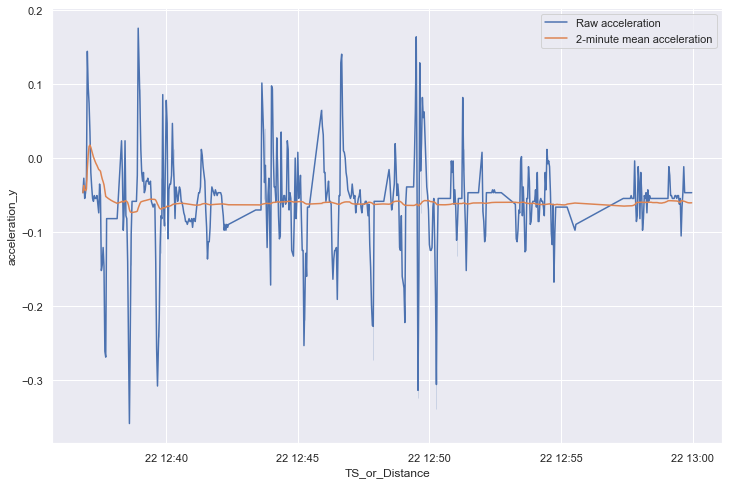

In [53]:
df_plot = df.reset_index()
df_plot = df_plot[(df_plot.TS_or_Distance > "2021-04-22 12:00") & (df_plot.TS_or_Distance < "2021-04-22 13:00")]

fig = plt.figure(figsize=(12, 8))
sns.lineplot(data=df_plot, x='TS_or_Distance', y='acceleration_y', label='Raw acceleration')
sns.lineplot(data=df_plot, x='TS_or_Distance', y='acceleration_y_mean', label='2-minute mean acceleration')

plt.legend()
fig.show()

C:\Users\s174420\AppData\Local\Temp\ipykernel_1236\1767237971.py:8: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.



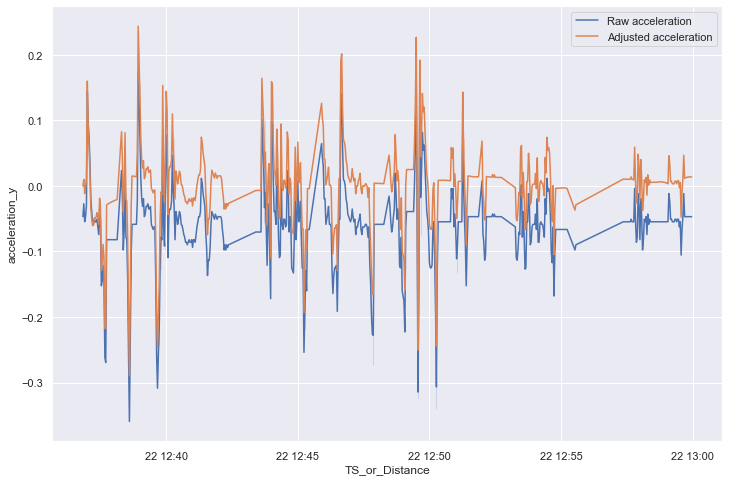

In [54]:
df_plot['adjusted_acceleration_y'] = df_plot['acceleration_y'] - df_plot['acceleration_y_mean']

fig = plt.figure(figsize=(12, 8))
sns.lineplot(data=df_plot, x='TS_or_Distance', y='acceleration_y', label='Raw acceleration')
sns.lineplot(data=df_plot, x='TS_or_Distance', y='adjusted_acceleration_y', label='Adjusted acceleration')

plt.legend()
fig.show()

In [55]:
df_plot.acceleration_y_mean.mean()

-0.059306028359062665

In [56]:
df_plot.adjusted_acceleration_y.mean()

-0.0010426087789271092

In [97]:
df['adjusted_acceleration_y'] = df['acceleration_y'] - df['acceleration_y_mean']
df['adjusted_acceleration_x'] = df['acceleration_x'] - df['acceleration_x_mean']

## Binary variables

### Speeding

In [58]:
# Speeding if exceeds by 5%
df['is_speeding'] = df['velocity'] > (df['speed_limit'] * 1.05)

### Acceleration

In [59]:
# Acceleration

# Car 0-50 km/h in seconds
# https://www.renaultgroup.com/en/news-on-air/news/the-renault-zoe-motor-energy-efficiency-and-power/#:~:text=It%20has%20a%20torque%20of,h%20takes%20just%206.5%20seconds.
zero_to_50_s = 3.5

meters = 50 * 1000
# m / s^2 = (m / s) * (1 / zero_to_100)
max_acceleration = (meters / 3600) / zero_to_50_s

# Acceleration in g's
max_acc_gs = max_acceleration / 9.82

print(f'Maximum acceleration [g] = {max_acc_gs:.3f}')

Maximum acceleration [g] = 0.404


In [60]:
df.adjusted_acceleration_y.describe()

count    103952.000000
mean         -0.000168
std           0.062706
min          -0.402543
25%          -0.018851
50%           0.000676
75%           0.020043
max           0.386816
Name: adjusted_acceleration_y, dtype: float64

<AxesSubplot:>

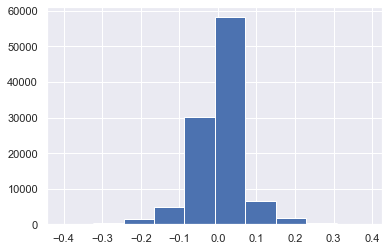

In [61]:
df.adjusted_acceleration_y.hist()

In [73]:
# Define hard acceleration as anything equal or above 80% of max
df['is_hard_acceleration'] = df['adjusted_acceleration_y'] >= (max_acc_gs * 0.80)

# Define medium acceleration as anything equal or above 50% of max and below 80%
df['is_medium_acceleration'] = (df['adjusted_acceleration_y'] >= (max_acc_gs * 0.50)) & (
            df['adjusted_acceleration_y'] < (max_acc_gs * 0.8))

# Define easy acceleration as anything below 50% of max and above 20% of max
df['is_soft_acceleration'] = (df['adjusted_acceleration_y'] < (max_acc_gs * 0.5)) & (df['adjusted_acceleration_y'] > (max_acc_gs * 0.2))

In [74]:
df.value_counts(['is_hard_acceleration', 'is_medium_acceleration', 'is_soft_acceleration'])

is_hard_acceleration  is_medium_acceleration  is_soft_acceleration
False                 False                   False                   96675
                                              True                     6481
                      True                    False                     759
True                  False                   False                      37
dtype: int64

In [75]:
df.query('is_hard_acceleration')

,trip,street_name_start,segment_id,GPS_dt,lat_int,lon_int,acceleration_z,acceleration_y,acceleration_x,yaw_rate,...,pass,acceleration_y_mean,adjusted_acceleration_y,is_speeding,is_hard_acceleration,is_medium_acceleration,is_soft_acceleration,is_hard_braking,is_medium_braking,is_soft_braking
TS_or_Distance,,,,,,,,,,,,,,,,,,,,,
2021-04-13 05:46:58+00:00,7448.0,,2938.0,2.042,55.628799,12.569971,1.0117,0.2813,0.0938,210.40,...,0.0,-0.061118,0.342418,False,True,False,False,False,False,False
2021-04-13 06:51:52+00:00,7448.0,Ørestads Boulevard,3768.0,0.553,55.638476,12.582824,1.0117,0.2695,0.1250,204.80,...,2.0,-0.062034,0.331534,False,True,False,False,False,False,False
2021-04-13 06:51:52+00:00,7448.0,Ørestads Boulevard,2494.0,0.553,55.638476,12.582824,1.0117,0.2695,0.1250,204.80,...,5.0,-0.060841,0.330341,False,True,False,False,False,False,False
2021-04-13 07:05:30+00:00,7448.0,Tagensvej,4711.0,3.298,55.693679,12.566537,1.0117,0.2813,0.1250,204.10,...,5.0,-0.058810,0.340110,False,True,False,False,False,False,False
2021-04-22 01:49:32+00:00,7792.0,,6861.0,0.836,55.727145,12.550722,0.9688,0.2891,0.3711,187.50,...,3.0,-0.061145,0.350245,False,True,False,False,False,False,False
2021-04-22 01:49:32+00:00,7792.0,,3420.0,0.836,55.727145,12.550722,0.9688,0.2891,0.3711,187.50,...,4.0,-0.060486,0.349586,False,True,False,False,False,False,False
2021-04-22 02:42:00+00:00,7792.0,Vigerslevvej,4056.0,1.882,55.654286,12.487048,1.0078,0.3359,0.1289,205.10,...,2.0,-0.050916,0.386816,False,True,False,False,False,False,False
2021-04-22 02:42:00+00:00,7792.0,Vigerslevvej,9672.0,1.882,55.654286,12.487048,1.0078,0.3359,0.1289,205.10,...,4.0,-0.050284,0.386184,False,True,False,False,False,False,False
2021-04-22 02:55:04+00:00,7792.0,Grøndals Parkvej,1770.0,1.130,55.687779,12.501034,1.0156,0.2891,0.1211,205.20,...,1.0,-0.053207,0.342307,False,True,False,False,False,False,False


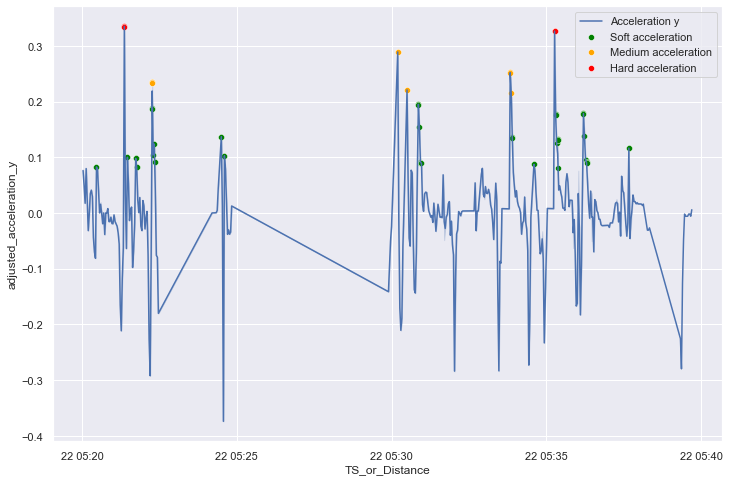

In [80]:
df_plot = df[(df.index > "2021-04-22 05:20") & (df.index < "2021-04-22 05:40")]

fig = plt.figure(figsize=(12, 8))
sns.lineplot(data=df_plot, x='TS_or_Distance', y='adjusted_acceleration_y', label='Acceleration y')
sns.scatterplot(data=df_plot.query('is_soft_acceleration'), x='TS_or_Distance', y='adjusted_acceleration_y',
                label='Soft acceleration', color='green', s=50)
sns.scatterplot(data=df_plot.query('is_medium_acceleration'), x='TS_or_Distance', y='adjusted_acceleration_y',
                label='Medium acceleration', color='orange', s=50)
sns.scatterplot(data=df_plot.query('is_hard_acceleration'), x='TS_or_Distance', y='adjusted_acceleration_y',
                label='Hard acceleration', color='red', s=50)

plt.legend()
plt.show()

### Braking

In [81]:
# Define hard braking as anything equal or above 80% of max
df['is_hard_braking'] = -df['adjusted_acceleration_y'] >= (max_acc_gs * 0.80)

# Define medium braking as anything equal or above 50% of max and below 80%
df['is_medium_braking'] = (-df['adjusted_acceleration_y'] >= (max_acc_gs * 0.50)) & (-df['adjusted_acceleration_y'] < (max_acc_gs * 0.8))

# Define easy braking as anything below 50% of max and above 20% of max
df['is_soft_braking'] = (-df['adjusted_acceleration_y'] < (max_acc_gs * 0.5)) & (-df['adjusted_acceleration_y'] > (max_acc_gs * 0.2))

In [82]:
df.value_counts(['is_hard_braking', 'is_medium_braking', 'is_soft_braking'])

is_hard_braking  is_medium_braking  is_soft_braking
False            False              False              96447
                                    True                6499
                 True               False                958
True             False              False                 48
dtype: int64

In [83]:
df.query('is_hard_braking')

,trip,street_name_start,segment_id,GPS_dt,lat_int,lon_int,acceleration_z,acceleration_y,acceleration_x,yaw_rate,...,pass,acceleration_y_mean,adjusted_acceleration_y,is_speeding,is_hard_acceleration,is_medium_acceleration,is_soft_acceleration,is_hard_braking,is_medium_braking,is_soft_braking
TS_or_Distance,,,,,,,,,,,,,,,,,,,,,
2021-04-13 05:30:46+00:00,7448.0,Røde Mellemvej,1780.0,0.284,55.644093,12.591585,0.95115,-0.41800,0.2500,197.00,...,0.0,-0.058288,-0.359712,False,False,False,False,True,False,False
2021-04-13 06:51:46+00:00,7448.0,Ørestads Boulevard,3753.0,0.285,55.638337,12.582769,0.97270,-0.42970,0.1484,206.30,...,2.0,-0.061922,-0.367778,False,False,False,False,True,False,False
2021-04-13 06:51:46+00:00,7448.0,Ørestads Boulevard,2479.0,0.285,55.638337,12.582769,0.97270,-0.42970,0.1484,206.30,...,5.0,-0.063274,-0.366426,False,False,False,False,True,False,False
2021-04-22 01:22:52+00:00,7792.0,Vigerslevvej,3440.0,0.301,55.660802,12.483493,0.98050,-0.43750,0.1328,204.30,...,3.0,-0.053271,-0.384229,False,False,False,False,True,False,False
2021-04-22 01:26:40+00:00,7792.0,Vigerslevvej,3849.0,0.311,55.666322,12.485485,0.96480,-0.40630,0.1914,204.50,...,3.0,-0.060376,-0.345924,False,False,False,False,True,False,False
2021-04-22 01:26:40+00:00,7792.0,Vigerslevvej,408.0,0.311,55.666322,12.485485,0.96480,-0.40630,0.1914,204.50,...,4.0,-0.061243,-0.345057,False,False,False,False,True,False,False
2021-04-22 02:42:40+00:00,7792.0,Vigerslevvej,43.0,0.282,55.658509,12.484519,0.96880,-0.42580,0.1719,204.30,...,1.0,-0.050270,-0.375530,False,False,False,False,True,False,False
2021-04-22 02:42:40+00:00,7792.0,Vigerslevvej,4180.0,0.282,55.658509,12.484519,0.96880,-0.42580,0.1719,204.30,...,2.0,-0.050890,-0.374910,False,False,False,False,True,False,False
2021-04-22 04:38:10+00:00,7805.0,Kalkbrænderihavnsgade,354.0,0.303,55.707461,12.590750,0.96480,-0.44530,0.1992,203.60,...,2.0,-0.052543,-0.392757,False,False,False,False,True,False,False


C:\Users\s174420\AppData\Local\Temp\ipykernel_1236\387972495.py:13: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.



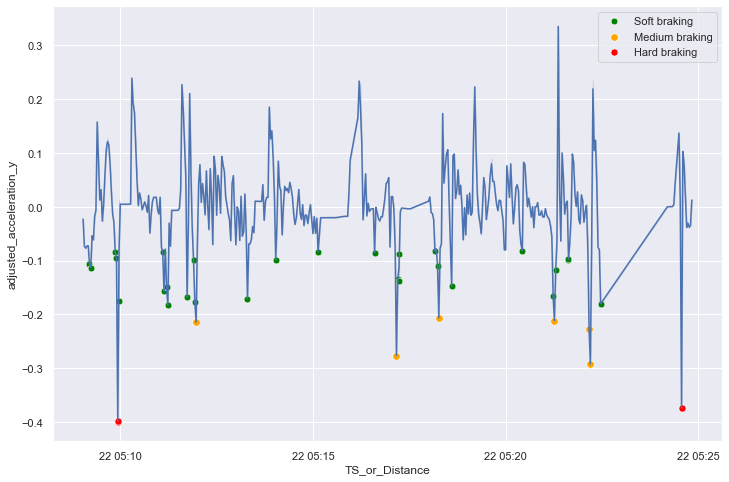

In [90]:
df_plot = df[(df.index > "2021-04-22 05:09") & (df.index < "2021-04-22 05:25")]

fig = plt.figure(figsize=(12, 8))
sns.lineplot(data=df_plot, x='TS_or_Distance', y='adjusted_acceleration_y')
sns.scatterplot(data=df_plot.query('is_soft_braking'), x='TS_or_Distance', y='adjusted_acceleration_y',
                label='Soft braking', color='green', s=50)
sns.scatterplot(data=df_plot.query('is_medium_braking'), x='TS_or_Distance', y='adjusted_acceleration_y',
                label='Medium braking', color='orange', s=50)
sns.scatterplot(data=df_plot.query('is_hard_braking'), x='TS_or_Distance', y='adjusted_acceleration_y',
                label='Hard braking', color='red', s=50)

plt.legend()
fig.show()

### Turning force

In [98]:
df.adjusted_acceleration_x.describe()

count    103952.000000
mean         -0.000023
std           0.040833
min          -0.395904
25%          -0.015684
50%          -0.001011
75%           0.014328
max           0.456336
Name: adjusted_acceleration_x, dtype: float64

<AxesSubplot:>

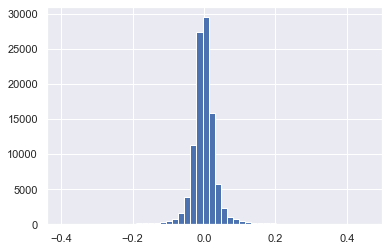

In [100]:
df.adjusted_acceleration_x.hist(bins=50)

<AxesSubplot:>

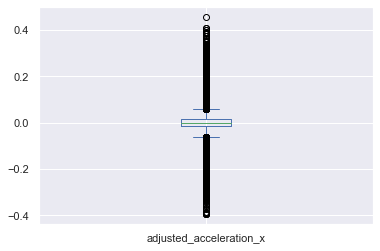

In [114]:
df.adjusted_acceleration_x.plot(kind='box')

In [132]:
# We will use the quantiles of the normal distribution, as we can see it closely follows such. Therefore assumptions hold :) ish
x_acc = df['adjusted_acceleration_x']

# Hard quantiles
q_hard_upper = df.adjusted_acceleration_x.quantile(0.99)
q_hard_lower = df.adjusted_acceleration_x.quantile(0.01)

# Medium quantiles
q_medium_upper = df.adjusted_acceleration_x.quantile(0.975)
q_medium_lower = df.adjusted_acceleration_x.quantile(0.025)

# Soft quantiles
q_soft_upper = df.adjusted_acceleration_x.quantile(0.9)
q_soft_lower = df.adjusted_acceleration_x.quantile(0.1)

df['is_hard_turning'] = (x_acc >= q_hard_upper) | (x_acc <= q_hard_lower)
df['is_medium_turning'] = ((x_acc < q_hard_upper) & (x_acc >= q_medium_upper)) | ((x_acc > q_hard_lower) & (x_acc <= q_medium_lower))
df['is_soft_turning'] = ((x_acc < q_medium_upper) & (x_acc >= q_soft_upper)) | ((x_acc > q_medium_lower) & (x_acc <= q_soft_lower))

In [133]:
df.value_counts(['is_hard_turning','is_medium_turning', 'is_soft_turning'])

is_hard_turning  is_medium_turning  is_soft_turning
False            False              False              83159
                                    True               15595
                 True               False               3118
True             False              False               2080
dtype: int64

In [134]:
df.query('is_hard_turning').head(10)

,trip,street_name_start,segment_id,GPS_dt,lat_int,lon_int,acceleration_z,acceleration_y,acceleration_x,yaw_rate,...,is_medium_acceleration,is_soft_acceleration,is_hard_braking,is_medium_braking,is_soft_braking,acceleration_x_mean,adjusted_acceleration_x,is_hard_turning,is_medium_turning,is_soft_turning
TS_or_Distance,,,,,,,,,,,,,,,,,,,,,
2021-04-13 05:20:18+00:00,7448.0,Landgreven,7.0,0.328,55.683102,12.585216,0.97660,0.08785,0.3418,185.80,...,False,True,False,False,False,0.180840,0.160960,True,False,False
2021-04-13 05:20:50+00:00,7448.0,Store Kongensgade,81.0,1.111,55.682774,12.586432,0.97660,0.09770,0.3477,184.20,...,False,True,False,False,False,0.186350,0.161350,True,False,False
2021-04-13 05:21:20+00:00,7448.0,Kongens Nytorv,155.0,0.297,55.681131,12.585034,1.01170,-0.12500,-0.0078,215.90,...,False,False,False,False,False,0.172091,-0.179891,True,False,False
2021-04-13 05:23:02+00:00,7448.0,Holmens Kanal,406.0,0.300,55.677315,12.584639,0.99610,-0.16020,0.0078,209.50,...,False,False,False,False,True,0.168198,-0.160398,True,False,False
2021-04-13 05:23:20+00:00,7448.0,Børsbroen,466.0,0.288,55.675744,12.584724,1.00000,-0.09770,0.0234,209.20,...,False,False,False,False,False,0.166639,-0.143239,True,False,False
2021-04-13 05:23:24+00:00,7448.0,Børsgade,480.0,0.296,55.675545,12.585095,1.02340,0.06250,0.0000,210.90,...,False,True,False,False,False,0.164973,-0.164973,True,False,False
2021-04-13 05:23:32+00:00,7448.0,Børsgade,507.0,0.281,55.675202,12.586483,0.97270,-0.00390,0.3398,198.00,...,False,False,False,False,False,0.166740,0.173060,True,False,False
2021-04-13 05:23:32+00:00,7448.0,Knippelsbro,510.0,0.285,55.675119,12.586619,0.95700,0.04300,0.3828,194.90,...,False,True,False,False,False,0.168798,0.214002,True,False,False
2021-04-13 05:29:10+00:00,7448.0,Amagerfælledvej,1473.0,0.303,55.655309,12.594090,0.97075,-0.00780,0.3125,197.70,...,False,False,False,False,False,0.159021,0.153479,True,False,False


C:\Users\s174420\AppData\Local\Temp\ipykernel_1236\3688620891.py:13: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.



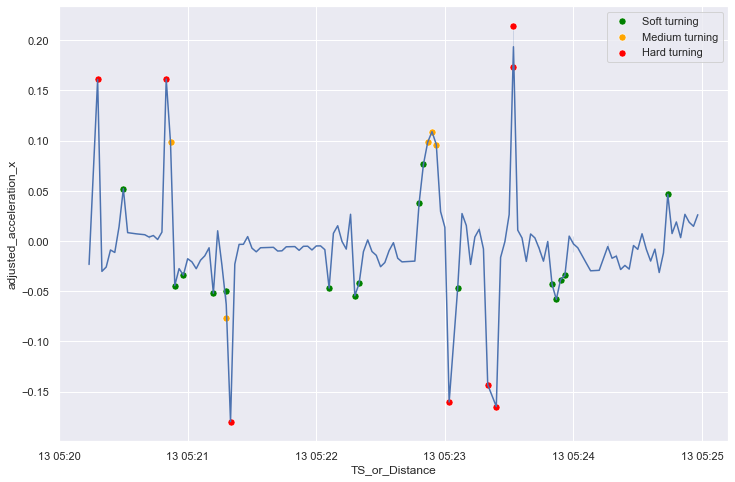

In [135]:
df_plot = df[(df.index > "2021-04-13 05:20") & (df.index < "2021-04-13 05:25")]

fig = plt.figure(figsize=(12, 8))
sns.lineplot(data=df_plot, x='TS_or_Distance', y='adjusted_acceleration_x')
sns.scatterplot(data=df_plot.query('is_soft_turning'), x='TS_or_Distance', y='adjusted_acceleration_x',
                label='Soft turning', color='green', s=50)
sns.scatterplot(data=df_plot.query('is_medium_turning'), x='TS_or_Distance', y='adjusted_acceleration_x',
                label='Medium turning', color='orange', s=50)
sns.scatterplot(data=df_plot.query('is_hard_turning'), x='TS_or_Distance', y='adjusted_acceleration_x',
                label='Hard turning', color='red', s=50)

plt.legend()
fig.show()

## Window functions

### Rolling Variance

Measure how much a person accelerates or decelerates within a rolling window. Higher frequency of start/stop should weigh higher. The acceleration or deceleration magnitude is captured in the binary variables above.

In [161]:
for trip in trips:
    df.loc[df.trip == trip, 'acceleration_y_var'] = df.query(f'trip == {trip}')['adjusted_acceleration_y'].rolling('3min').var()
    df.loc[df.trip == trip, 'acceleration_x_var'] = df.query(f'trip == {trip}')['adjusted_acceleration_x'].rolling('3min').var()


C:\Users\s174420\AppData\Local\Temp\ipykernel_1236\1560517993.py:12: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.



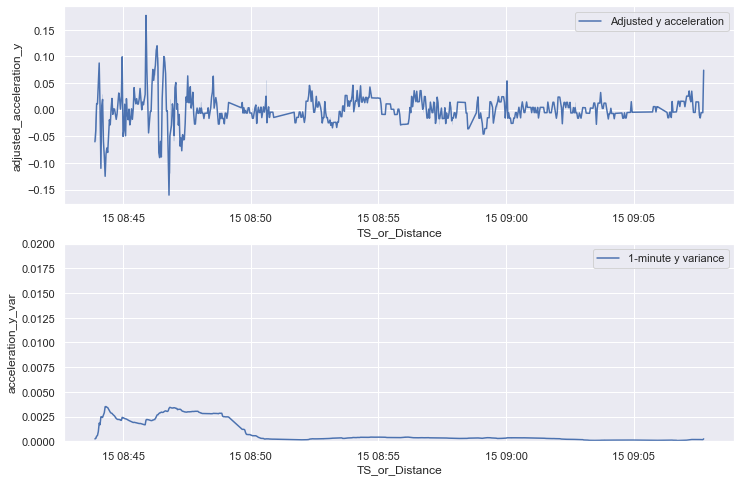

In [158]:
df_plot = df[(df.index > '2021-04-15 08:43') & (df.index < '2021-04-15 09:20')]

fig, [ax1, ax2] = plt.subplots(2, 1, figsize=(12, 8))
sns.lineplot(data=df_plot, x='TS_or_Distance', y='adjusted_acceleration_y', label='Adjusted y acceleration', ax=ax1)
sns.lineplot(data=df_plot, x='TS_or_Distance', y='acceleration_y_var', label='3-minute y variance', ax=ax2)

ax2.set(
    ylim=[0, 0.02]
)

plt.legend()
fig.show()

C:\Users\s174420\AppData\Local\Temp\ipykernel_1236\3396737140.py:12: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.



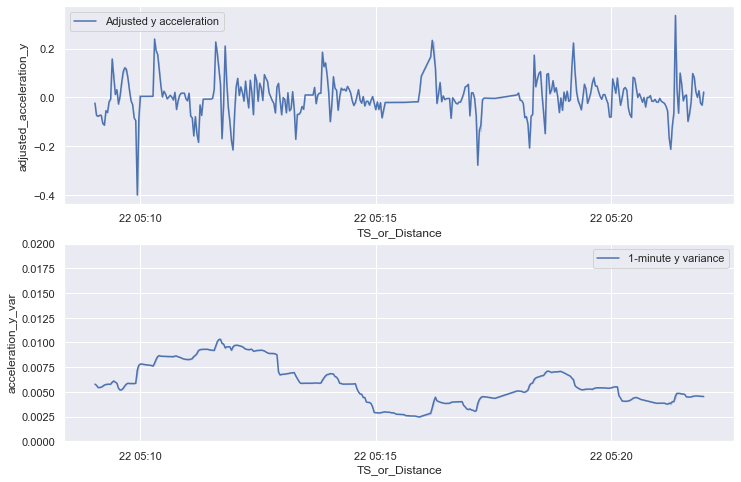

In [160]:
df_plot = df[(df.index > "2021-04-22 05:09") & (df.index < "2021-04-22 05:22")]

fig, [ax1, ax2] = plt.subplots(2, 1, figsize=(12, 8))
sns.lineplot(data=df_plot, x='TS_or_Distance', y='adjusted_acceleration_y', label='Adjusted y acceleration', ax=ax1)
sns.lineplot(data=df_plot, x='TS_or_Distance', y='acceleration_y_var', label='3-minute y variance', ax=ax2)

ax2.set(
    ylim=[0, 0.02]
)

plt.legend()
fig.show()

C:\Users\s174420\AppData\Local\Temp\ipykernel_1236\303445240.py:12: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.



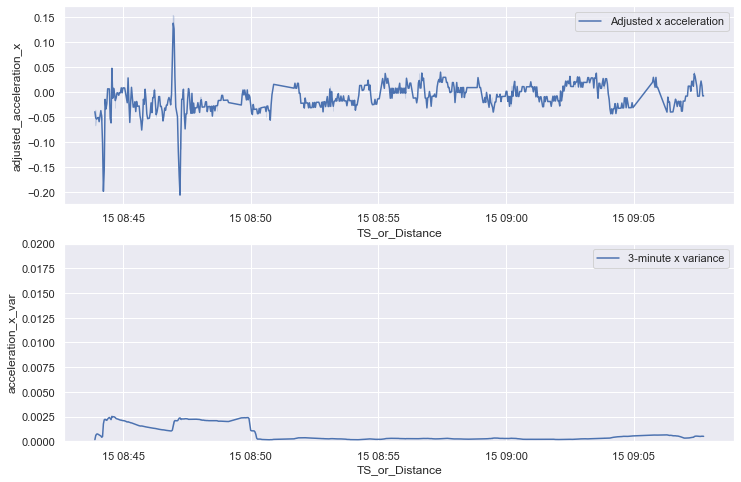

In [162]:
df_plot = df[(df.index > '2021-04-15 08:43') & (df.index < '2021-04-15 09:20')]

fig, [ax1, ax2] = plt.subplots(2, 1, figsize=(12, 8))
sns.lineplot(data=df_plot, x='TS_or_Distance', y='adjusted_acceleration_x', label='Adjusted x acceleration', ax=ax1)
sns.lineplot(data=df_plot, x='TS_or_Distance', y='acceleration_x_var', label='3-minute x variance', ax=ax2)

ax2.set(
    ylim=[0, 0.02]
)

plt.legend()
fig.show()

C:\Users\s174420\AppData\Local\Temp\ipykernel_1236\420690299.py:12: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.



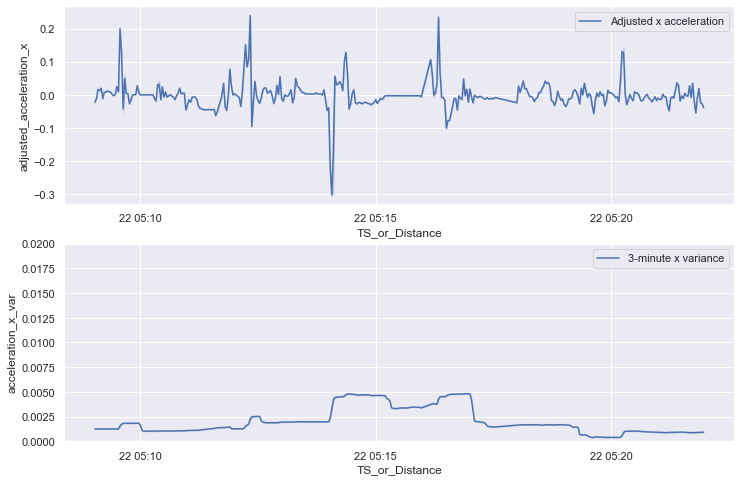

In [163]:
df_plot = df[(df.index > "2021-04-22 05:09") & (df.index < "2021-04-22 05:22")]

fig, [ax1, ax2] = plt.subplots(2, 1, figsize=(12, 8))
sns.lineplot(data=df_plot, x='TS_or_Distance', y='adjusted_acceleration_x', label='Adjusted x acceleration', ax=ax1)
sns.lineplot(data=df_plot, x='TS_or_Distance', y='acceleration_x_var', label='3-minute x variance', ax=ax2)

ax2.set(
    ylim=[0, 0.02]
)

plt.legend()
fig.show()